In [1]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
df = pd.read_csv('/home/peder/git/fish-forecast/Data-Exploration/catch_no_catch_env_data_all_depths.csv', sep=';')

# Create a list of depths
depths = [0, 3, 10, 15, 25, 50]

# Create separate dataframes for each depth
df_depths = {}
for depth in depths:
    # Select columns for specific depth and common columns
    depth_cols = [col for col in df.columns if f'd{depth}' in col]
    common_cols = ['Date', 'CatchLat', 'CatchLon', 'Rundvekt', 'Catch', 'nk800_h']
    
    # Combine the columns and create new dataframe
    df_depths[depth] = df[common_cols + depth_cols]

# Store each depth dataframe in separate variables
df_depth_0 = df_depths[0]
df_depth_3 = df_depths[3]
df_depth_10 = df_depths[10]
df_depth_15 = df_depths[15]
df_depth_25 = df_depths[25]
df_depth_50 = df_depths[50]

In [3]:
target = 'Catch'

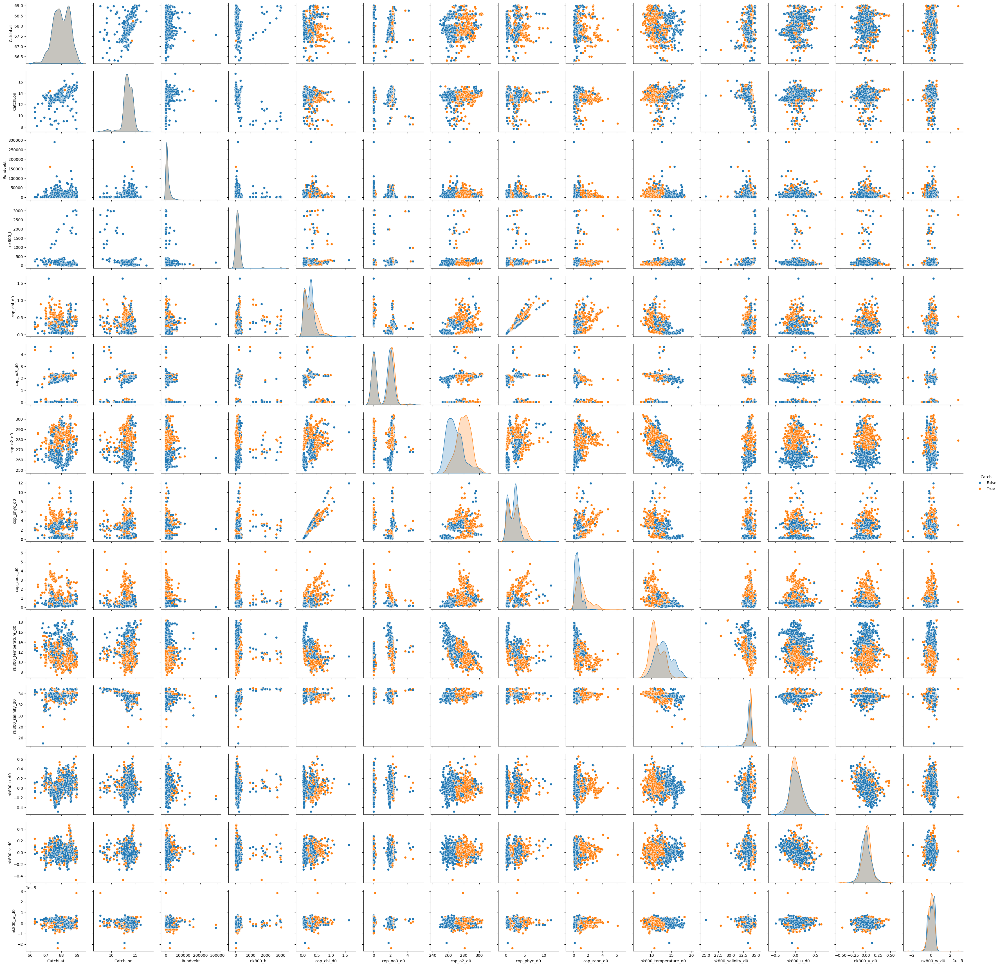

In [4]:
sns.pairplot(df_depth_0, diag_kind='kde', hue=target)

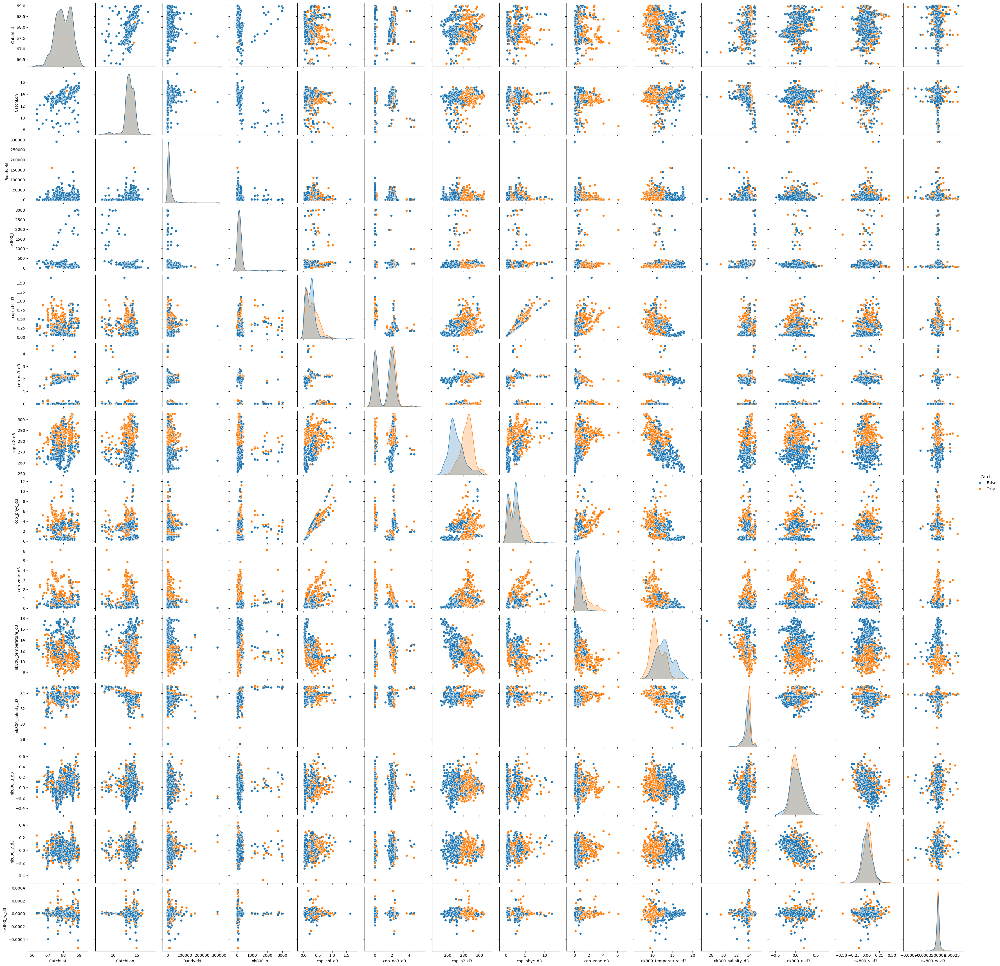

In [5]:
sns.pairplot(df_depth_3, diag_kind='kde', hue=target)

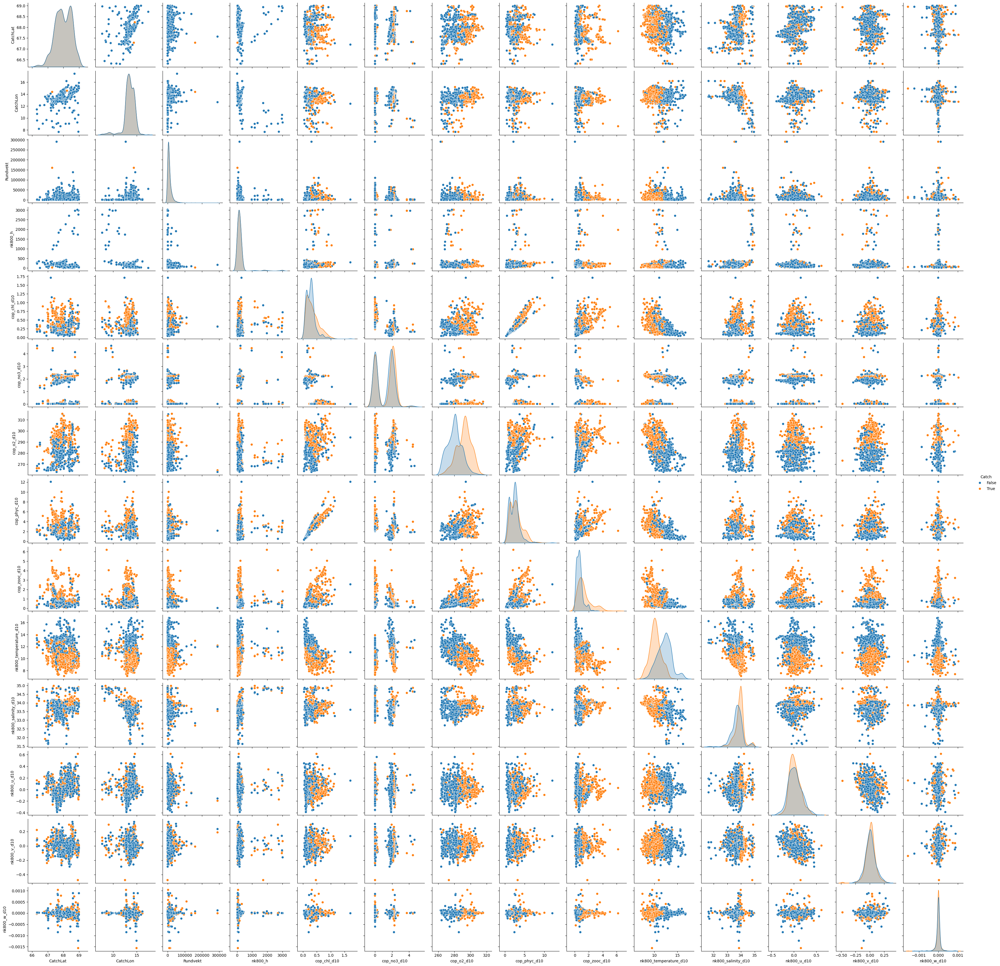

In [6]:
sns.pairplot(df_depth_10, diag_kind='kde', hue=target)

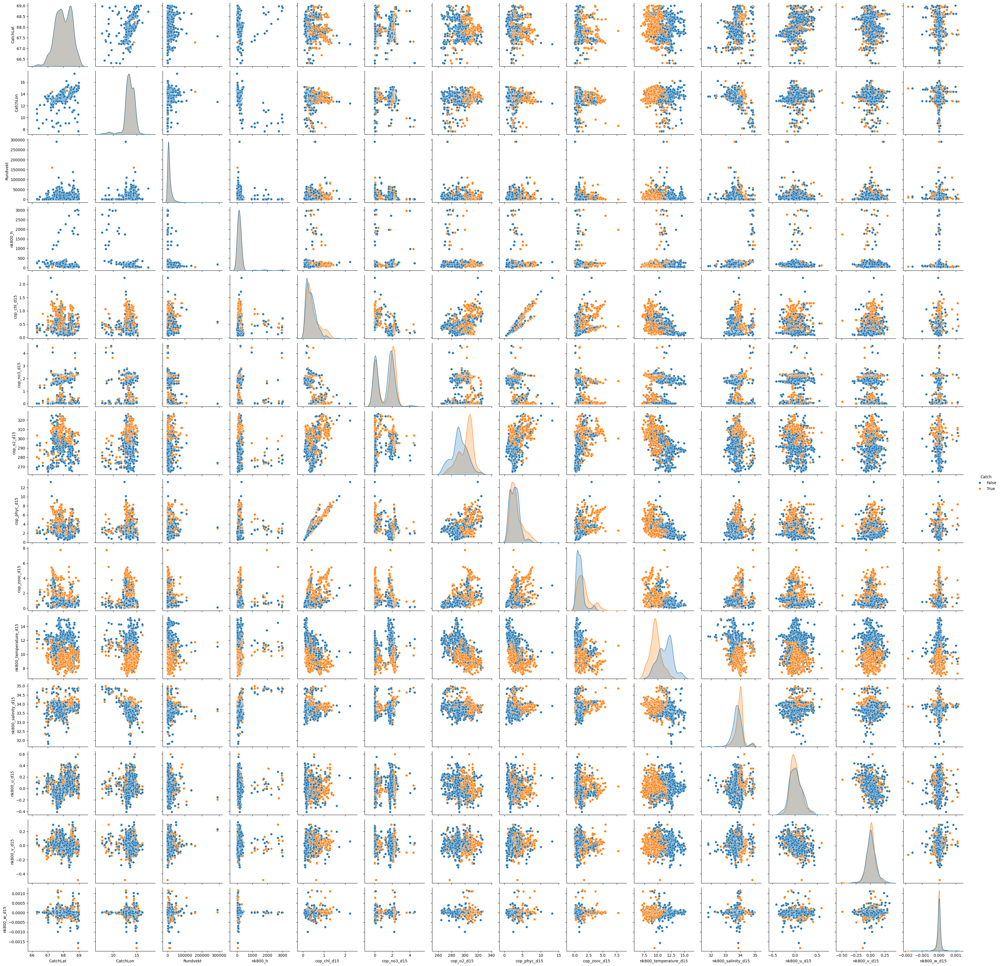

In [7]:
sns.pairplot(df_depth_15, diag_kind='kde', hue=target)

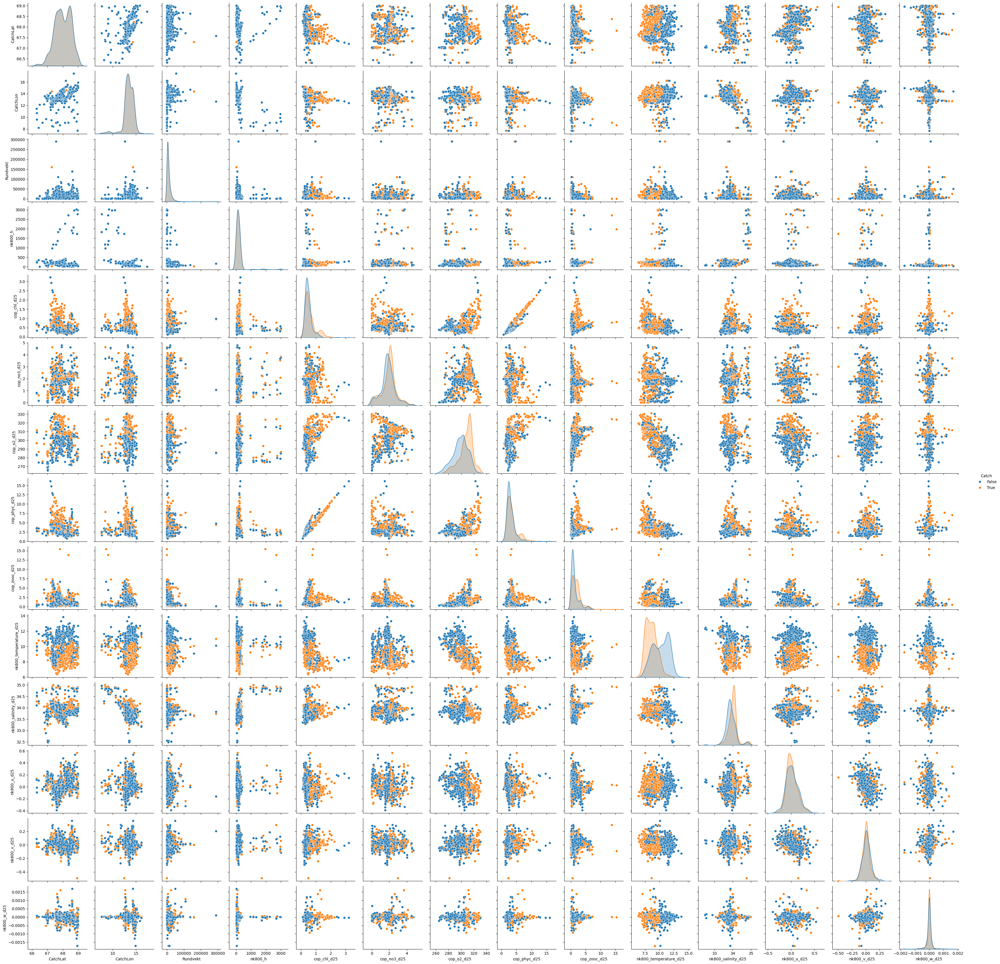

In [8]:
sns.pairplot(df_depth_25, diag_kind='kde', hue=target)

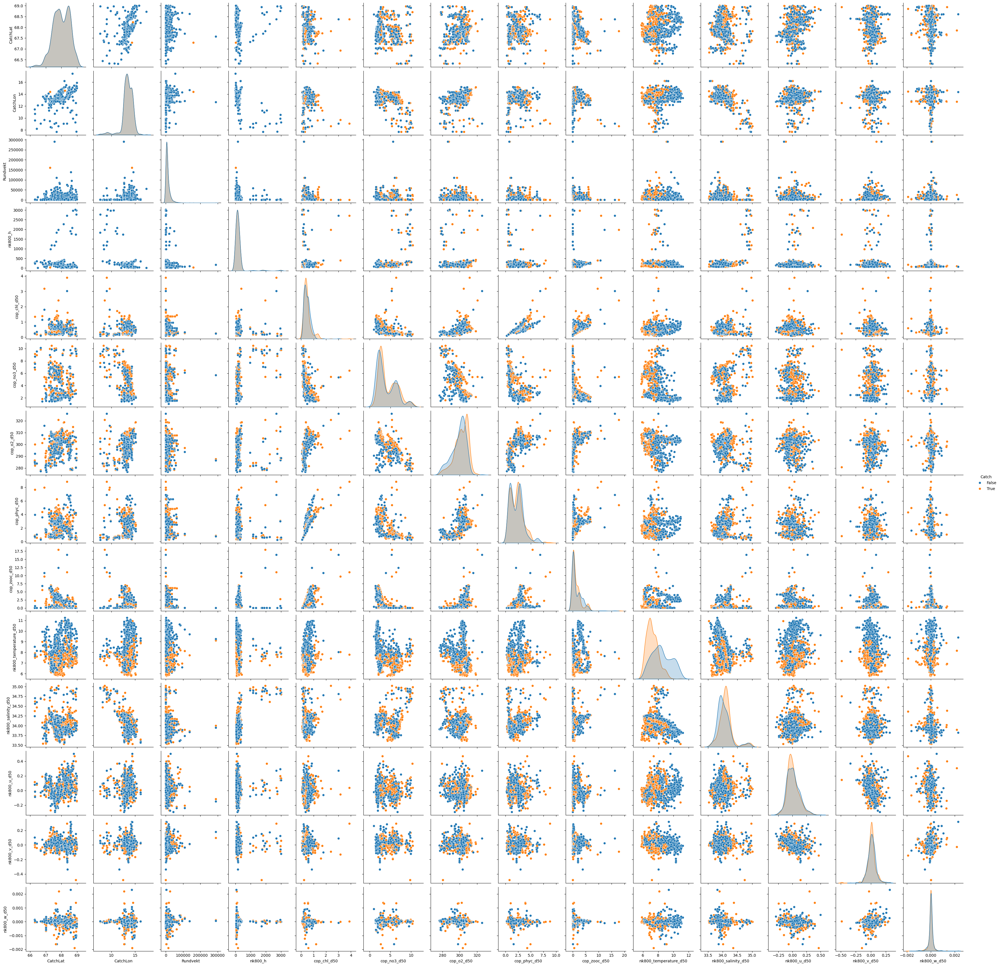

In [9]:
sns.pairplot(df_depth_50, diag_kind='kde', hue=target)

<Axes: >

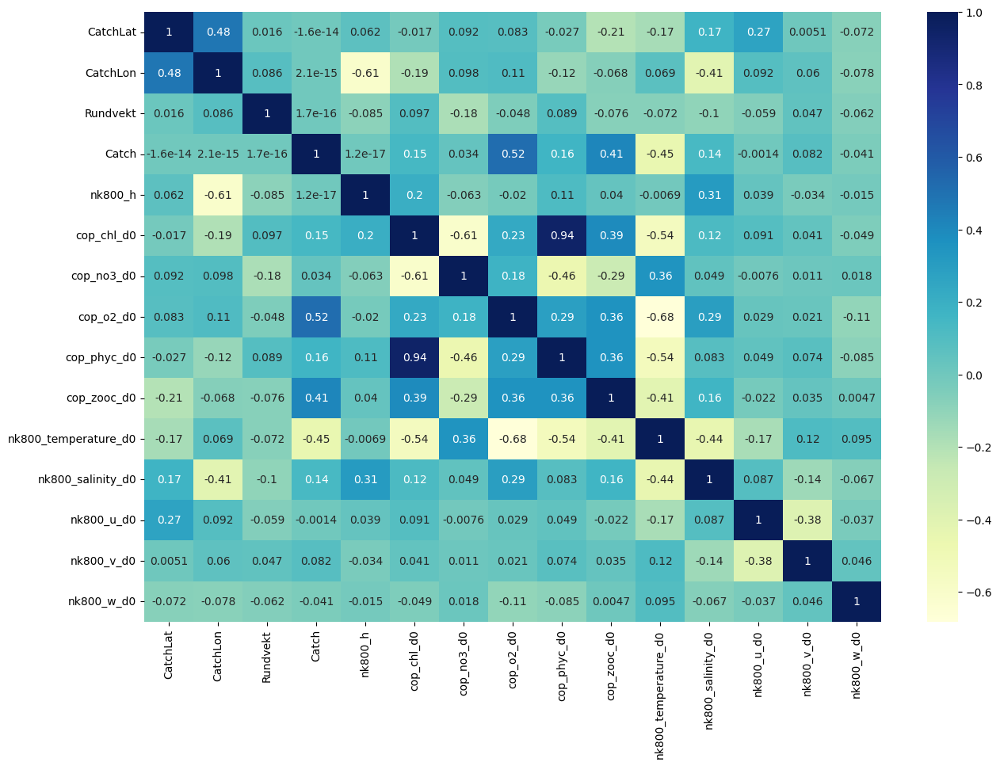

In [10]:
current_df = df_depth_0
df_corr = current_df.drop(['Date'], axis=1)
corr0 = current_df[df_corr.columns].corr()
plt.figure(figsize=(15,10)) # set X and Y size
sns.heatmap(corr0, cmap="YlGnBu", annot=True)

<Axes: >

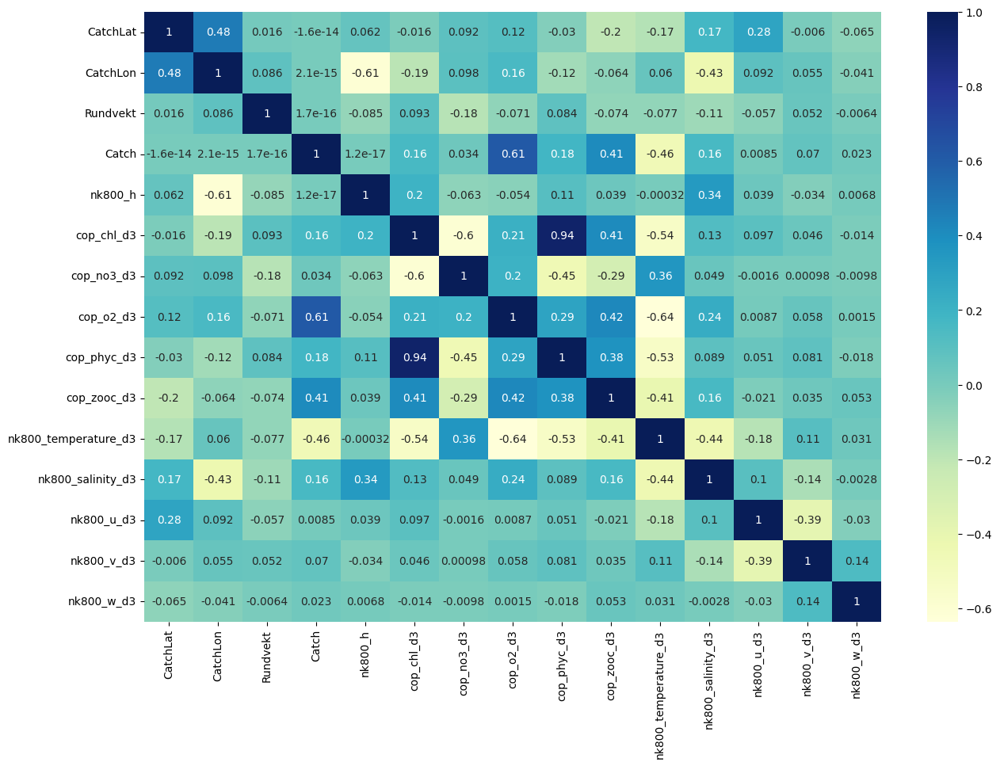

In [11]:
current_df = df_depth_3
df_corr = current_df.drop(['Date'], axis=1)
corr3 = current_df[df_corr.columns].corr()
plt.figure(figsize=(15,10)) # set X and Y size
sns.heatmap(corr3, cmap="YlGnBu", annot=True)

<Axes: >

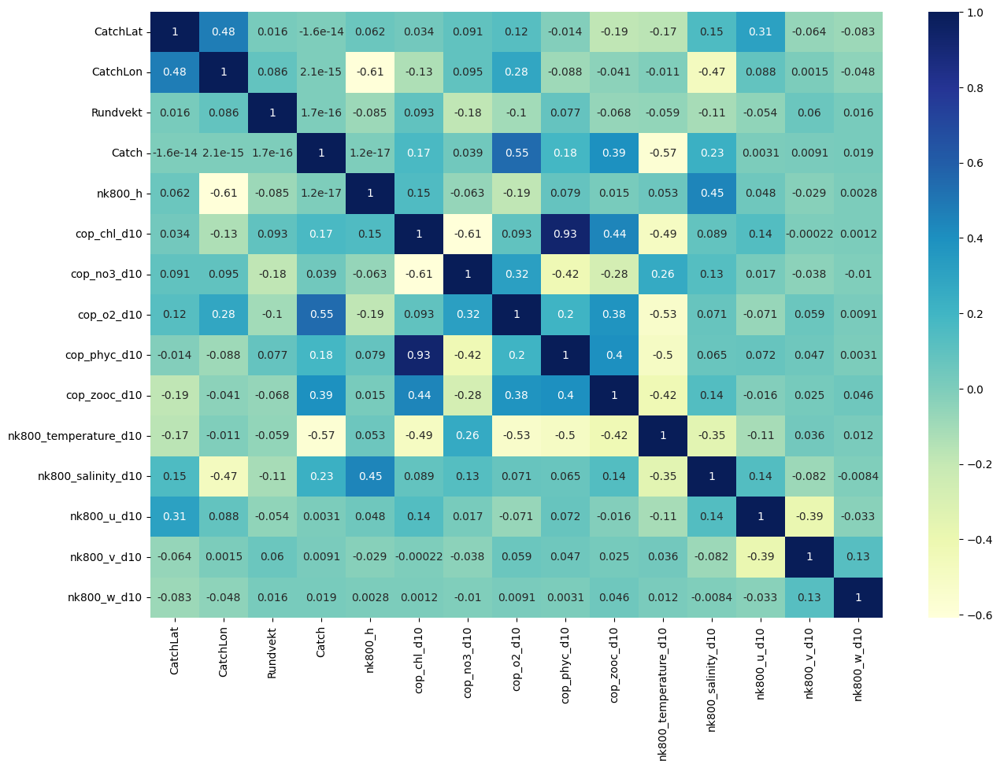

In [12]:
current_df = df_depth_10
df_corr = current_df.drop(['Date'], axis=1)
corr10 = current_df[df_corr.columns].corr()
plt.figure(figsize=(15,10)) # set X and Y size
sns.heatmap(corr10, cmap="YlGnBu", annot=True)

<Axes: >

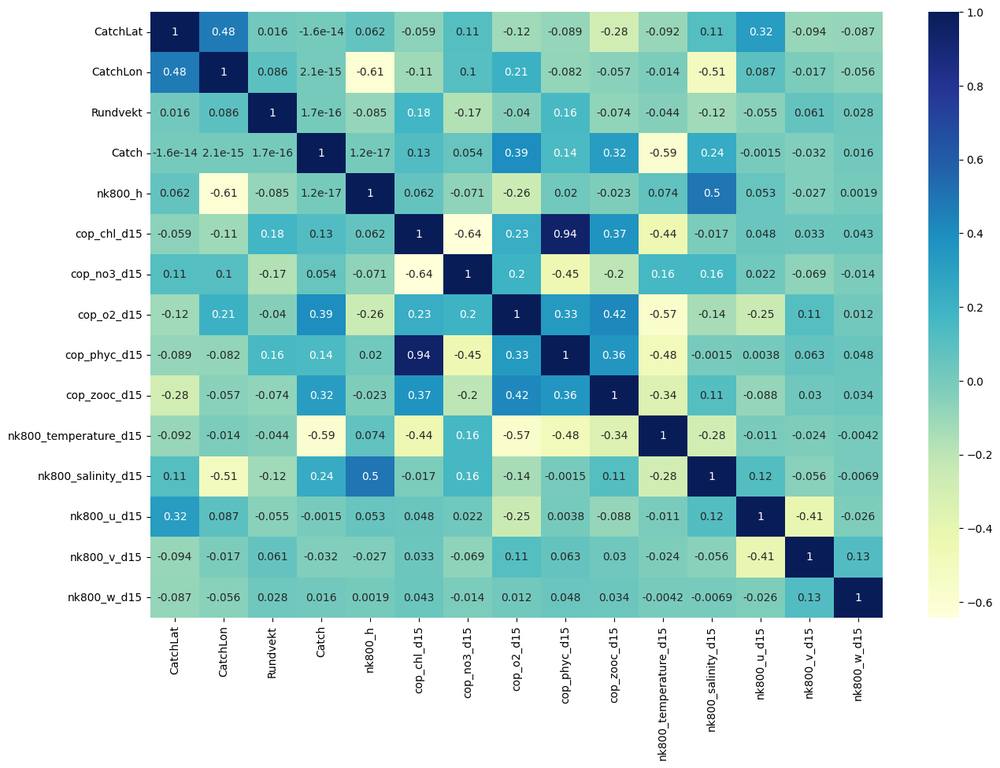

In [13]:
current_df = df_depth_15
df_corr = current_df.drop(['Date'], axis=1)
corr15 = current_df[df_corr.columns].corr()
plt.figure(figsize=(15,10)) # set X and Y size
sns.heatmap(corr15, cmap="YlGnBu", annot=True)

<Axes: >

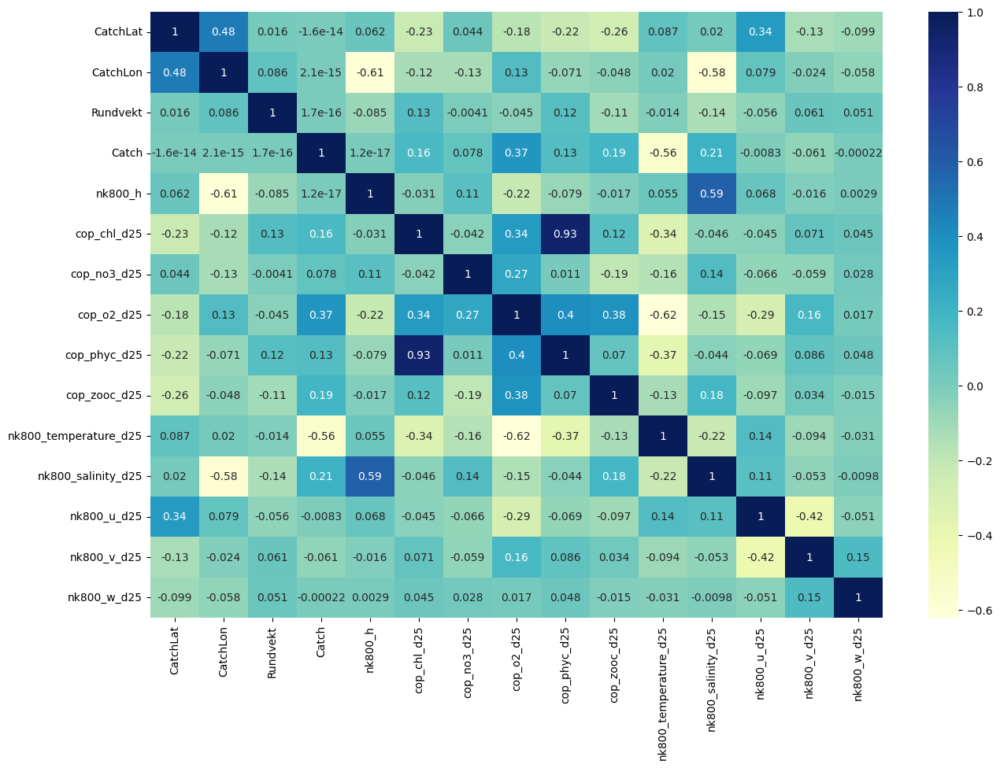

In [14]:
current_df = df_depth_25
df_corr = current_df.drop(['Date'], axis=1)
corr25 = current_df[df_corr.columns].corr()
plt.figure(figsize=(15,10)) # set X and Y size
sns.heatmap(corr25, cmap="YlGnBu", annot=True)

<Axes: >

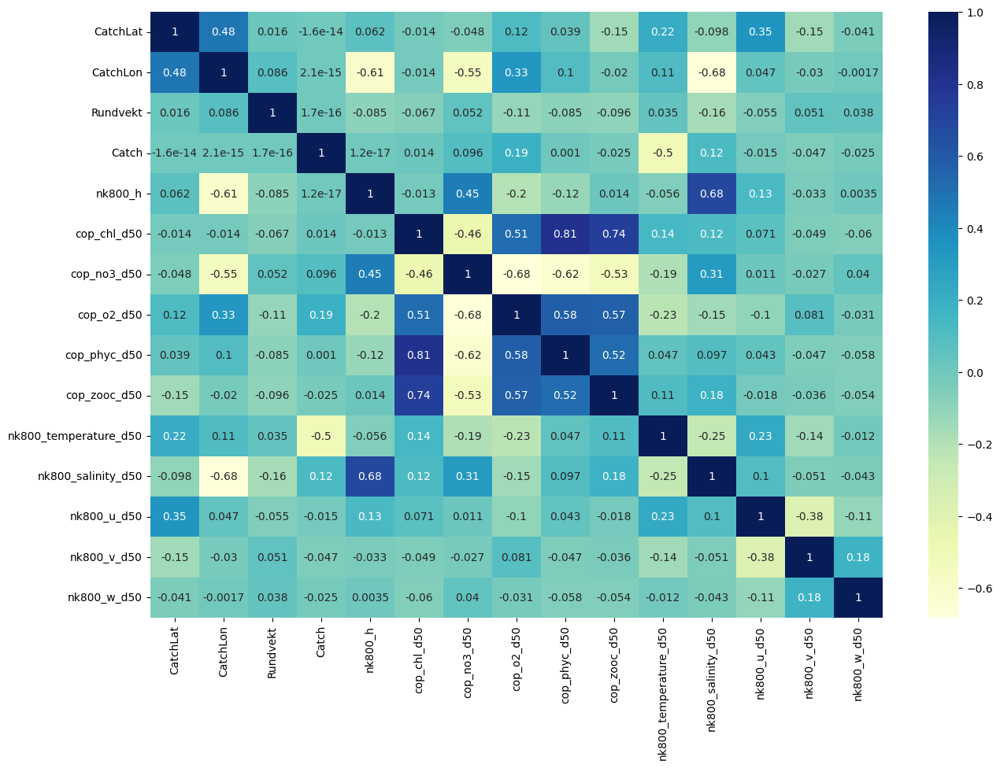

In [15]:
current_df = df_depth_50
df_corr = current_df.drop(['Date'], axis=1)
corr50 = current_df[df_corr.columns].corr()
plt.figure(figsize=(15,10)) # set X and Y size
sns.heatmap(corr50, cmap="YlGnBu", annot=True)

AttributeError: Rectangle.set() got an unexpected keyword argument 'marker'

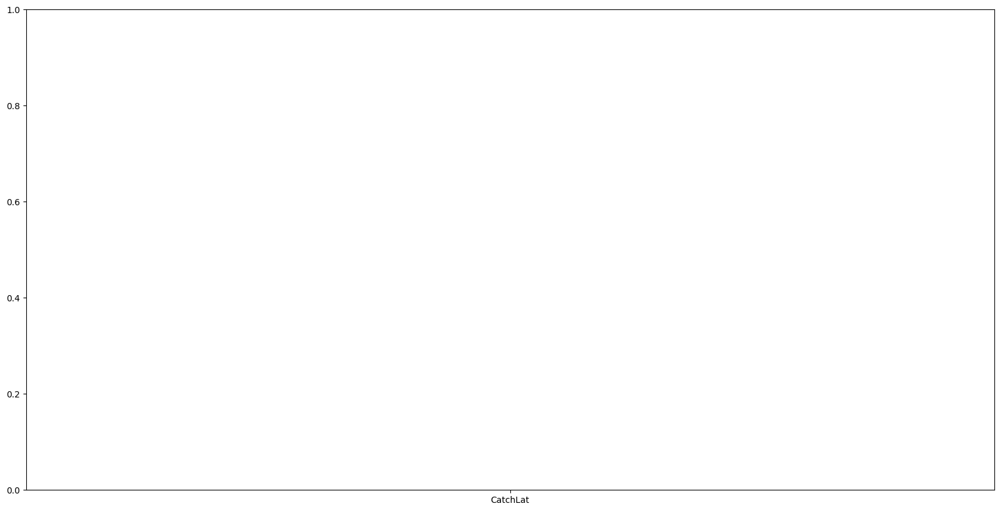

In [16]:
plt.figure(figsize=(20, 10))

# Create the plot with aligned variable names
for corr_matrix in [corr0, corr3, corr10, corr15, corr25, corr50]:
    # Remove depth suffixes from index names for alignment
    clean_index = [idx.split('_d')[0] if '_d' in idx else idx for idx in corr_matrix.index]
    plt.bar(clean_index, corr_matrix.Catch, marker='o', label=f"{corr_matrix.name if hasattr(corr_matrix, 'name') else ''}")

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Add labels and title
plt.xlabel('Variables')
plt.ylabel('Correlation with Catch')
plt.title('Correlation with Catch at Different Depths')

# Add legend with depth values
plt.legend(['0m', '3m', '10m', '15m', '25m', '50m'])
plt.grid()

# Adjust layout to prevent label cutoff
plt.tight_layout()


### Notable corrolations:
| Variable (depth = 0)| Correlation with Catch |
|----------|---------------------|
| cop_o2 | 0.54 |
| nk800_temperature | -0.45 |
| cop_zooc | 0.41 |
| cop_phyc | 0.16 |
| cop_chl | 0.15 |
| nk800_salinity | 0.14 |

In [ ]:
def create_depth_specific_df(variable_name):
	# Initialize empty dataframe
	df_temp = pd.DataFrame()
	
	# # Add the common columns
	# common_cols = ['Date', 'CatchLat', 'CatchLon', 'Rundvekt', 'Catch', 'nk800_h']
	# df_temp = df[common_cols].copy()
	
	# Add columns for each depth
	for depth in depths:
		column_name = f'{variable_name}_d{depth}'
		if column_name in df_depths[depth].columns:
			df_temp[column_name[-2:]] = df_depths[depth][column_name]
	
	return df_temp

# List of variables to process
variables = ['nk800_temperature', 'nk800_salinity', 'nk800_u', 'nk800_v', 'nk800_w', 
			'cop_chl', 'cop_no3', 'cop_o2', 'cop_phyc', 'cop_zooc']

# Create dictionary to store all variable-specific dataframes
variable_dfs = {}

# Process each variable
for var in variables:
	variable_dfs[var] = create_depth_specific_df(var)


# Plot the correlation between layers on the catch locations:

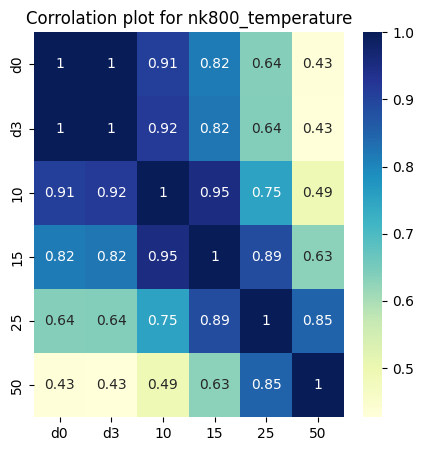

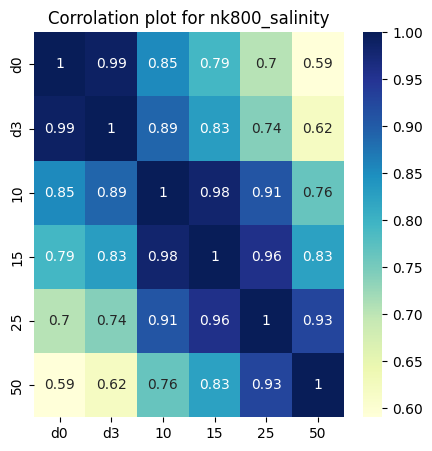

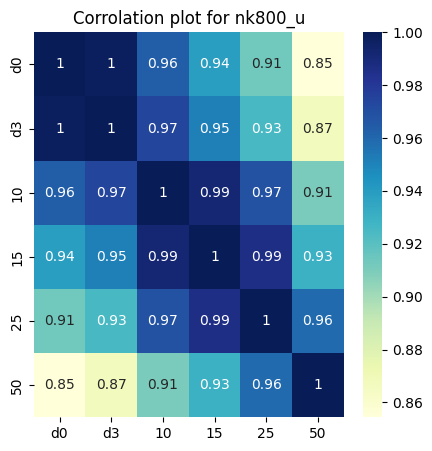

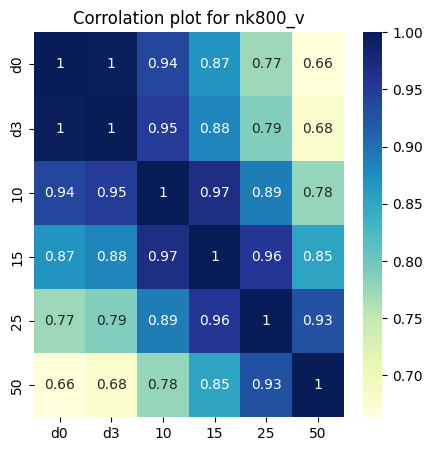

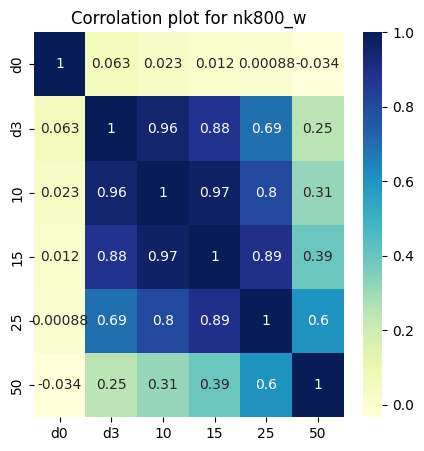

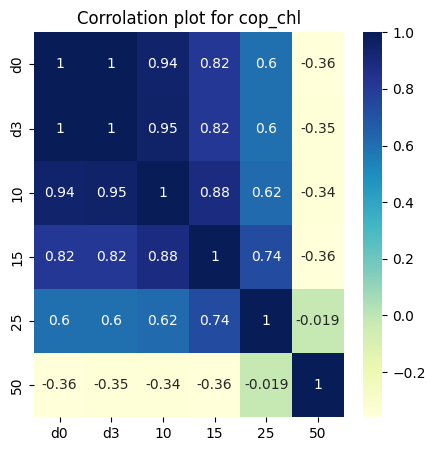

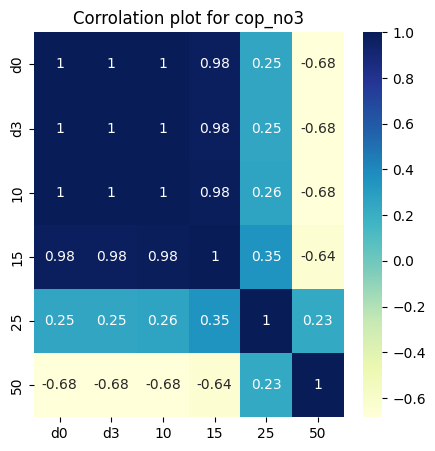

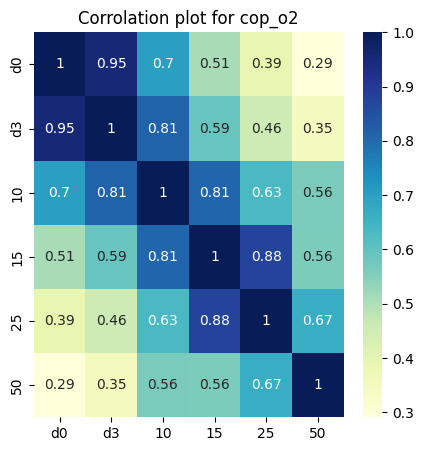

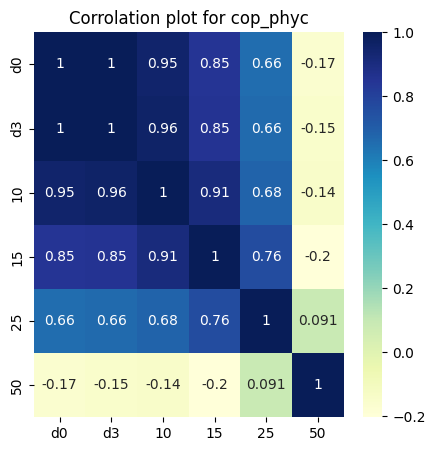

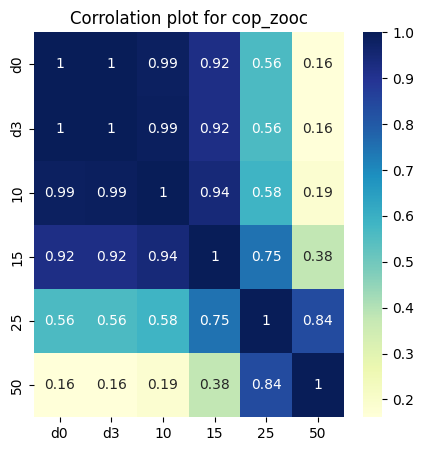

In [ ]:
for var in variables:
	current_df = variable_dfs[var]
	corr50 = current_df[current_df.columns].corr()
	plt.figure(figsize=(5,5)) # set X and Y size
	plt.title(f'Corrolation plot for {var}')
	sns.heatmap(corr50, cmap="YlGnBu", annot=True)

ValueError: num must be an integer with 1 <= num <= 18, not 19

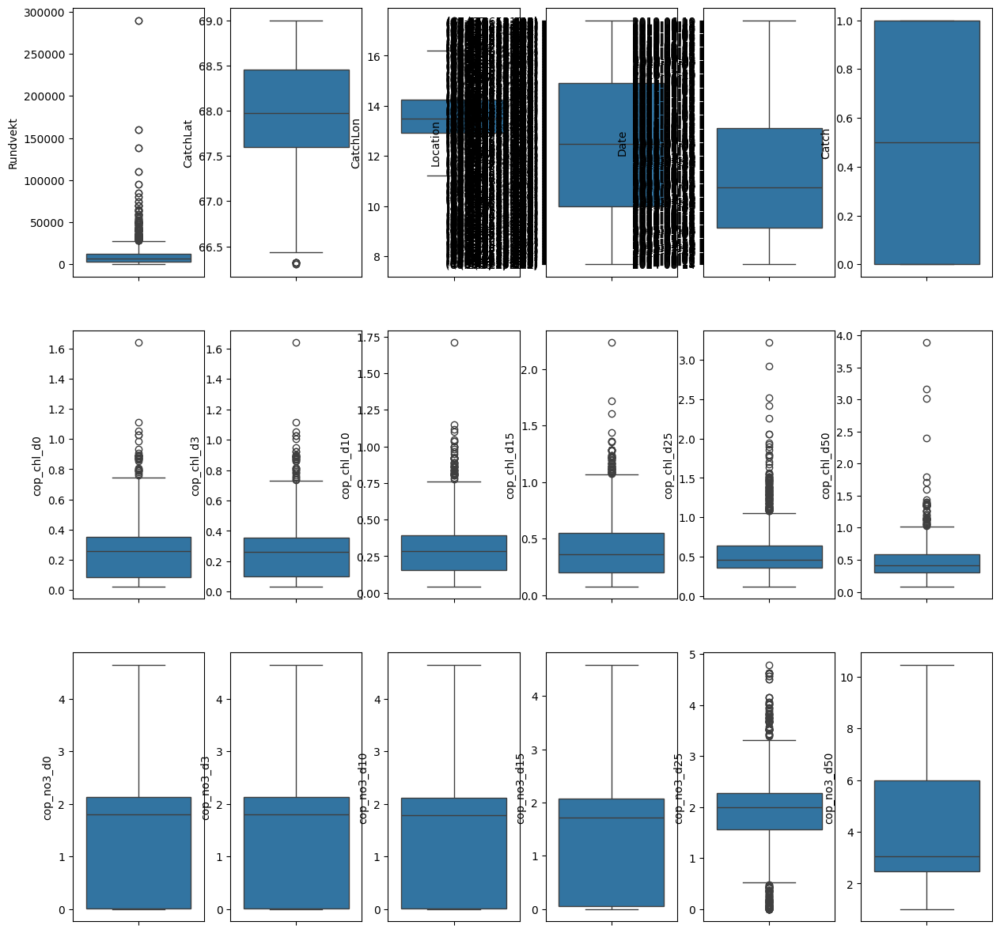

In [ ]:

#--Checking Outliers
plt.figure(figsize=(15,15))
pos = 1
# print(df.columns)
for i in df.columns:
    plt.subplot(3, 6, pos)
    sns.boxplot(data=df[i])
    pos += 1

Index(['Rundvekt', 'CatchLat', 'CatchLon', 'Catch', 'w_class', 'q_class'], dtype='object')


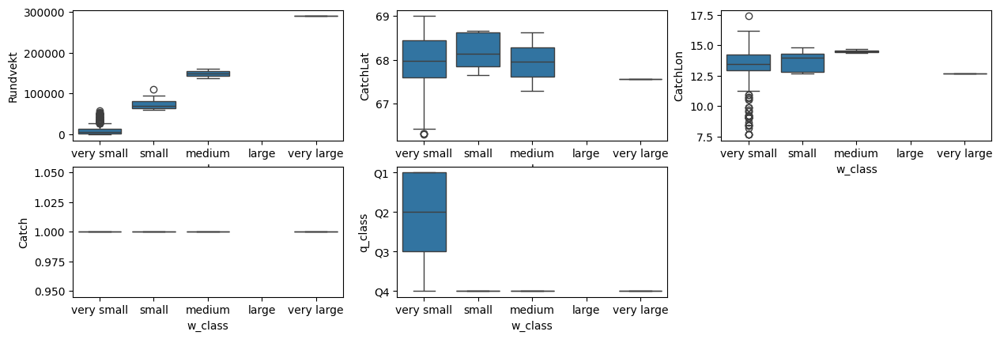

In [ ]:
target = target_w
predictors = list(df.columns)
print(df.columns)
predictors.remove(target)
predictors
#--Checking Outliers
plt.figure(figsize=(15,15))
pos = 1
for p in predictors:
    plt.subplot(6, 3, pos)
    sns.boxplot(x=target, y=p, data=df)
    pos += 1